## New-Horizon Slices to show Density, Temperature, and Entropy Distribution. 

#### Necessary imports and system information

In [28]:
%matplotlib inline

import numpy as np
import matplotlib.pyplot as plt
import matplotlib
from mpl_toolkits import mplot3d
from matplotlib import cm
import mpl_toolkits.mplot3d.art3d as art3d
import os
import pandas as pd


matplotlib.rcParams['font.family'] = [ 'Times New Roman']
matplotlib.rcParams['agg.path.chunksize'] = 10000

import sys  
sys.path.insert(0, '/Users/zaraafrooz/Desktop/Cosmic_Filaments_AstroCom/filament_work_zara/example_filaments')

import read_fils as rf

import struct

#print(sys.path)

from numpy import *
from scipy.io import FortranFile as fort
import numpy as np

#### Density, Temperature, and Entropy data extraction

In [29]:
## Density Data
f=fort('/Users/zaraafrooz/Desktop/Cosmic_Filaments_AstroCom/filament_work_zara/Simulation_data/NH_gas_large_rho.dat','r')
size=f.read_ints(np.int32)
print(size)
rho=f.read_reals('f4').reshape((409,409,409),order='F')
f.close()
print("maximum density" + str(np.max(rho)))
print("minimum density" + str(np.min(rho)))
print("average density" + str(np.mean(rho)))
print("median density" + str(np.median(rho)))

## Temperature Data
f=fort('/Users/zaraafrooz/Desktop/Cosmic_Filaments_AstroCom/filament_work_zara/Simulation_data/NH_gas_large_rho.dat','r')
size=f.read_ints(np.int32)
print(size)
T=f.read_reals('f4').reshape((409,409,409),order='F')
f.close()
print("maximum temperature" + str(np.max(T)))
print("minimum temperature" + str(np.min(T)))
print("average temperature" + str(np.mean(T)))
print("median temperature" + str(np.median(T)))

## Slicing and flattening thhe 3 dimensional plot into 2 dimensions 
## by taking projections of density, temperature, and entropy data between sections n1-n2
n1=1
n2=409

projr=np.sum(rho[n1:n2,1:409,1:409],axis=0)
projr = projr/(float(n2-n1+1))
lrho=np.log10(projr) ##log data
lrho1=np.log10(rho)

projT=np.sum(T[n1:n2,1:409,1:409],axis=0)
lT=np.log10(projT)
lT1=np.log10(T)


## Numerial extraction of Entropy based on density and temperature + slice projection
lS=(3.0/2.0)*lrho1-lT1
projS=np.sum(-lS[n1:n2,1:409,1:409],axis=0)
S=10**lS
lS1=np.log10(projS)


[409 409 409]
maximum density6054.1367
minimum density0.0020285032
average density0.13048092
median density0.033428125
[409 409 409]
maximum temperature6054.1367
minimum temperature0.0020285032
average temperature0.13048092
median temperature0.033428125


#### Plotting Density and Temperature Distribution


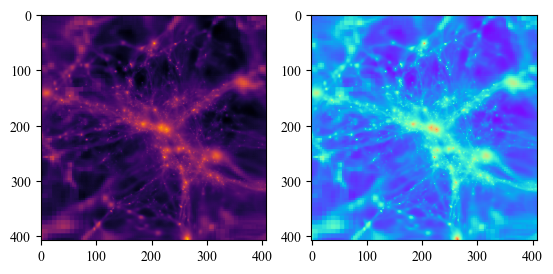

In [30]:
fig, ax = plt.subplots(nrows= 1, ncols = 2)
ax[0].imshow(lrho,aspect='auto', cmap= plt.colormaps['inferno'])
ax[0].set_box_aspect(1)

#save_to = '/Users/zaraafrooz/Desktop/'
#plt.savefig(save_to + 'cosmic_webs.png', dpi= 300)

ax[1].imshow(lT,aspect='auto', cmap=plt.colormaps['rainbow'])
ax[1].set_box_aspect(1)

plt.show()


#### Plotting density, temperature, and entropy distribution by projecting Y-Axis for every 10-pixel sections
##### Converting the pixels ticks to megaparsecs and setting the origin at the center of the image
##### -> 23.46 by 23.46 megaparsec projection plot is shown to be 409 by 409 pixels

0 10


/var/folders/43/phhlpyxx78q6pmmcs6tg_l400000gp/T/ipykernel_37105/2307053687.py:21: RuntimeWarning: invalid value encountered in log10
  lS1=np.log10(projS)


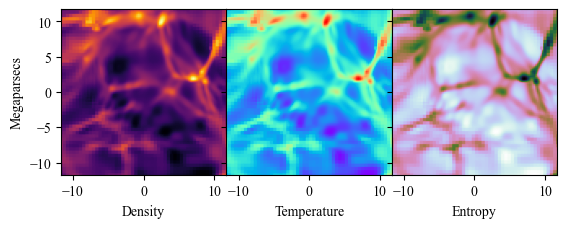

10 20


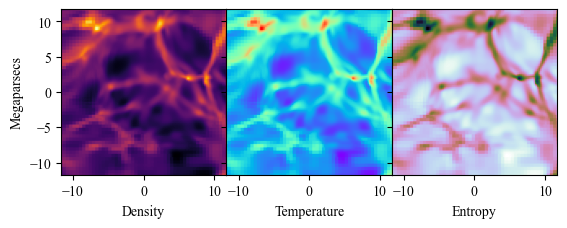

20 30


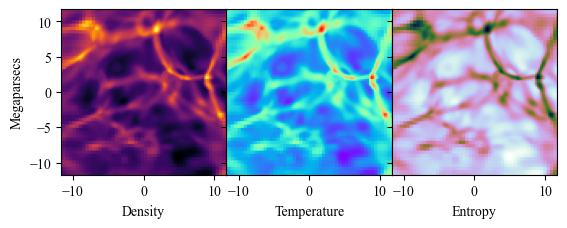

30 40


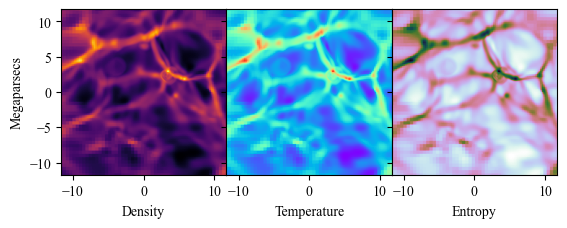

40 50


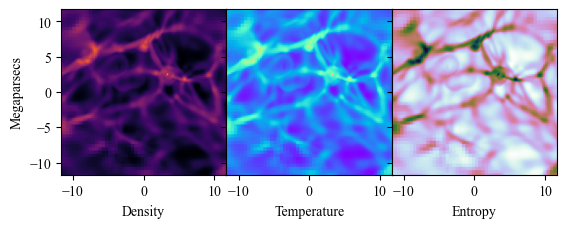

50 60


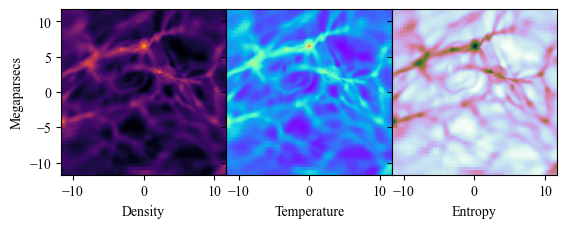

60 70


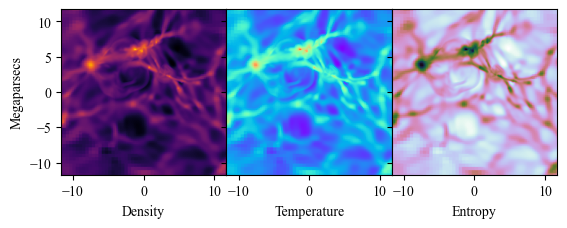

70 80


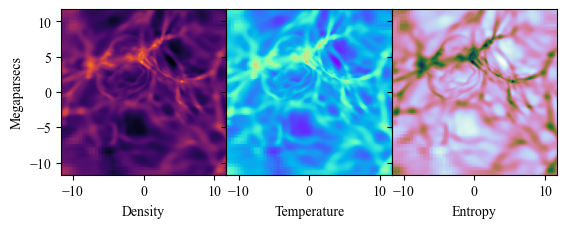

80 90


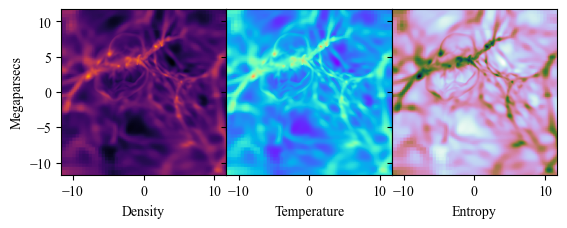

90 100


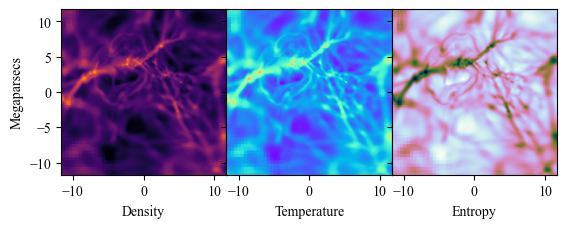

100 110


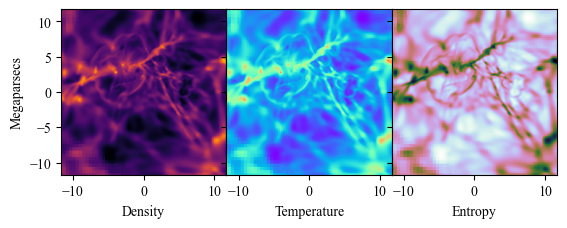

110 120


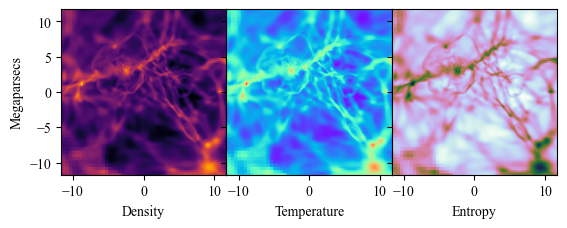

120 130


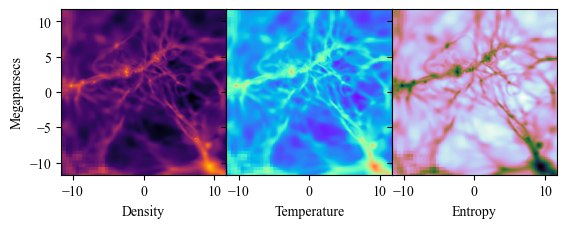

130 140


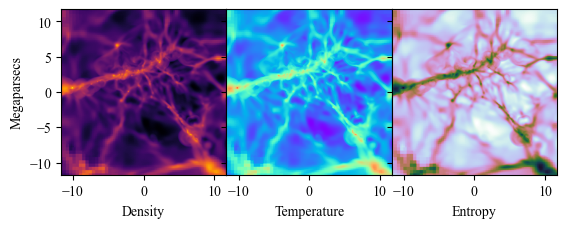

140 150


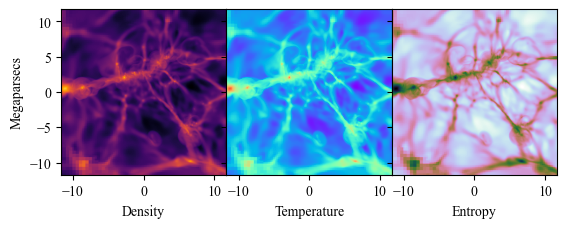

150 160


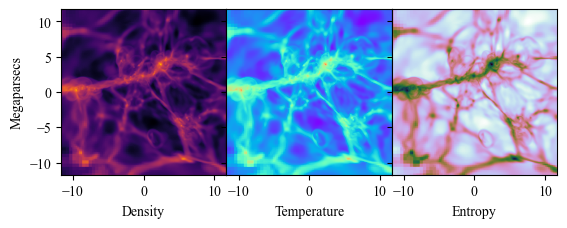

160 170


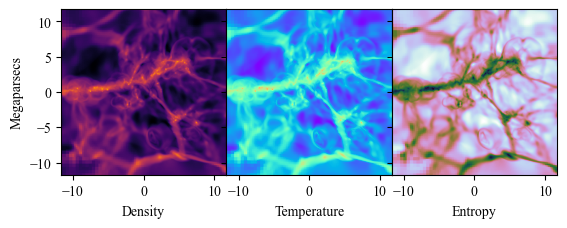

170 180


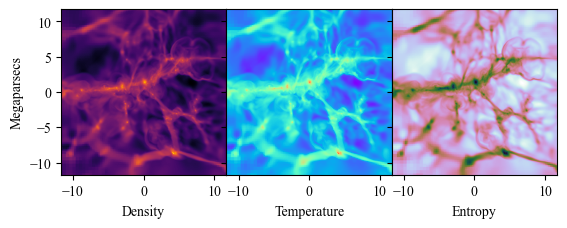

180 190


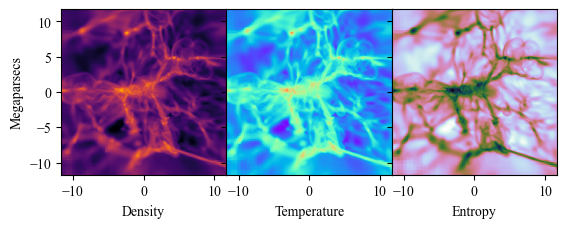

190 200


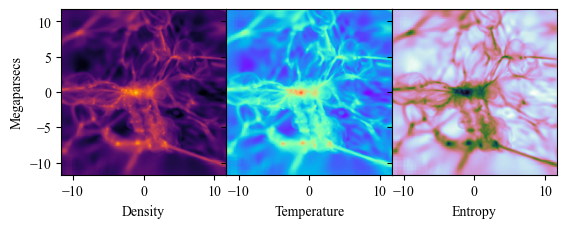

200 210


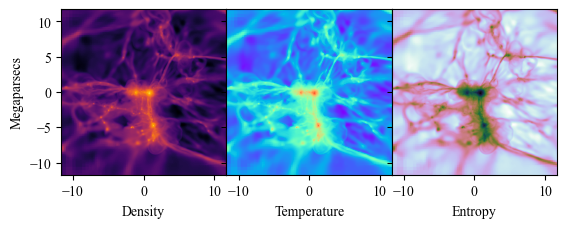

210 220


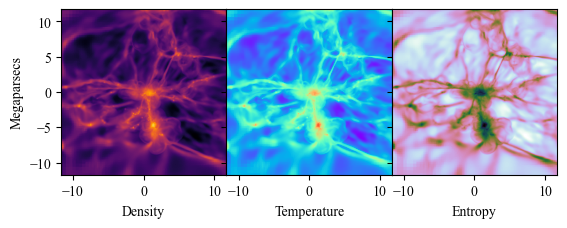

220 230


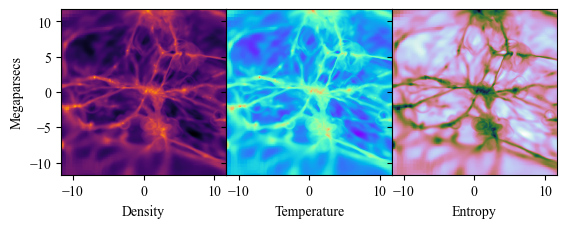

230 240


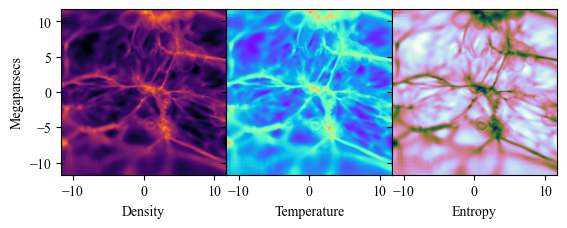

240 250


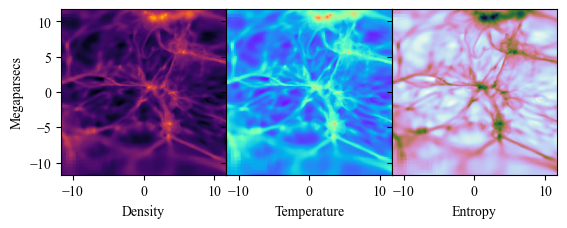

250 260


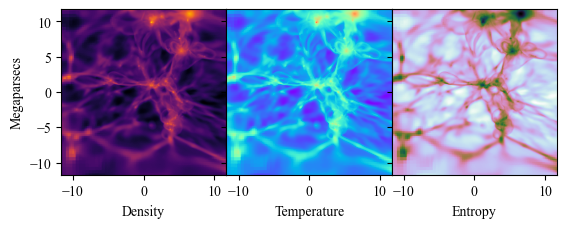

260 270


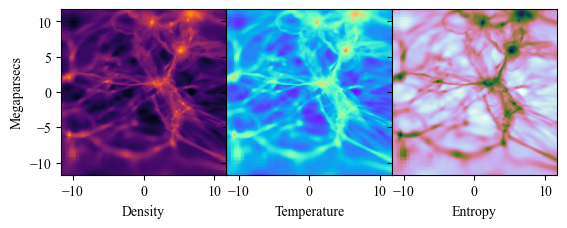

270 280


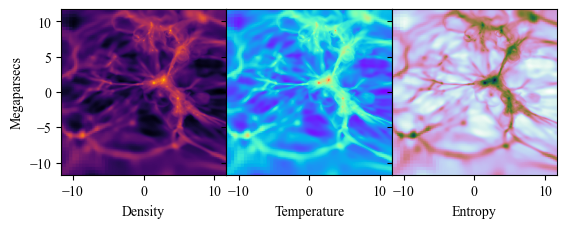

280 290


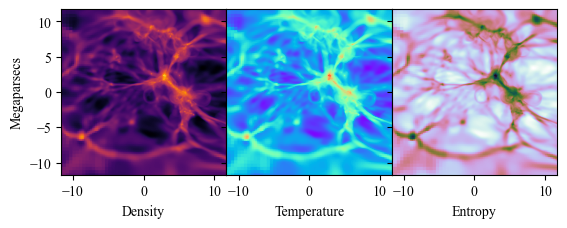

290 300


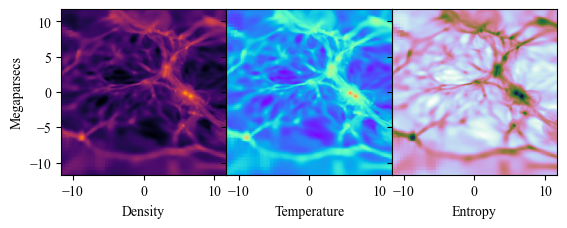

300 310


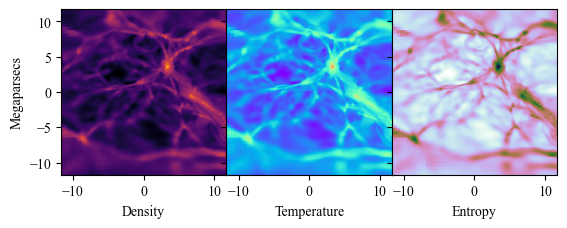

310 320


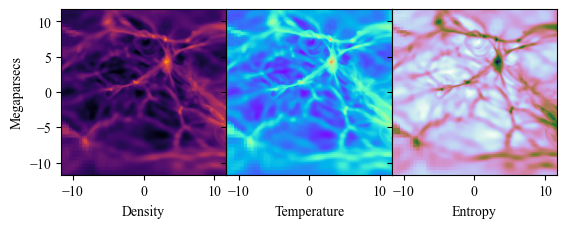

320 330


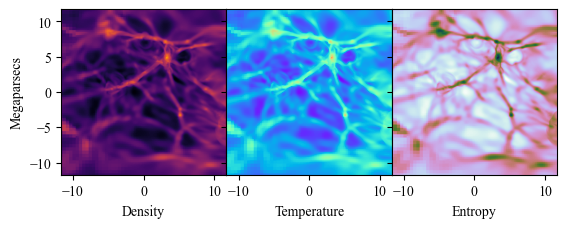

330 340


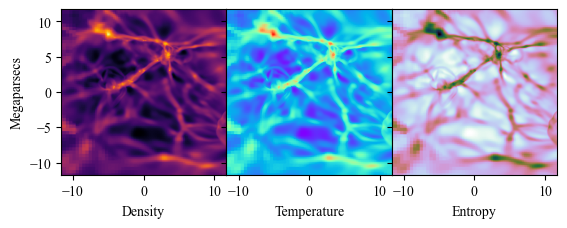

340 350


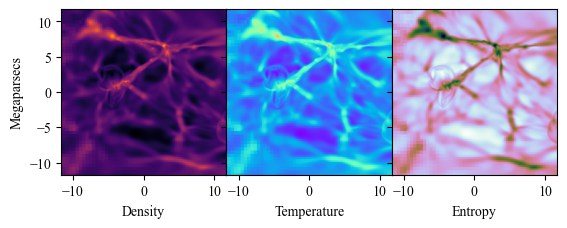

350 360


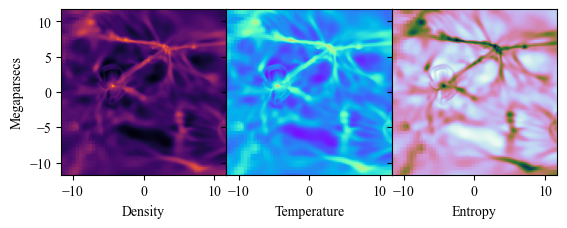

360 370


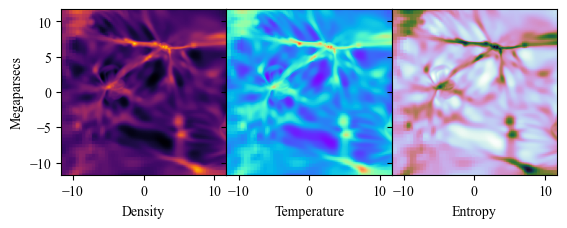

370 380


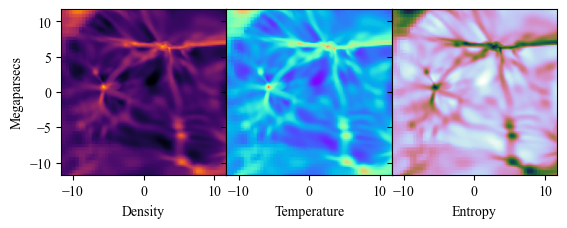

380 390


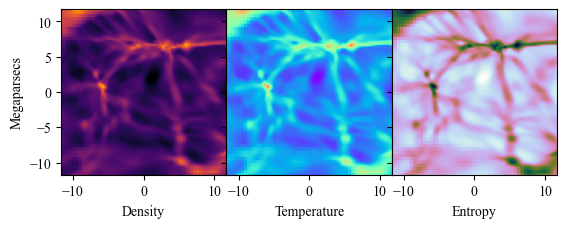

In [31]:
## Converting the pixels ticks to megaparsecs and setting the origin at the center of the image

for i in range(39): #looping to produce (409/n2-n1) plots. in this case i'm making 39 plots by slicing every ten pixels from the Y-dimension
    n1 = i*10 
    n2 = n1+10

    print(n1,n2) #to display which pixels it sliced from
    
    projr=np.sum(rho[1:409, n1:n2, 1:409],axis=1)
    projr = projr/(float(n2-n1+1))
    lrho=np.log10(projr)
    lrho1=np.log10(rho)

    projT=np.sum(T[1:409, n1:n2,1:409],axis=1)
    lT=np.log10(projT)
    lT1=np.log10(T)

    lS=(3.0/2.0)*lrho1-lT1
    S=10**lS
    projS=np.sum(-lS[1:409, n1:n2, 1:409],axis=1)
    lS1=np.log10(projS)
    
    fig, ax = plt.subplots(nrows= 1, ncols=3, sharey= True)
    plt.subplots_adjust(hspace = 0.0, wspace = 0.0)
    
    ax[0].imshow(lrho,aspect='auto', cmap= plt.colormaps['inferno'], extent=[-23.402640586797066/2,23.402640586797066/2,-23.402640586797066/2,23.402640586797066/2])
    ax[0].set_box_aspect(1)
    ax[0].set_ylabel('Megaparsecs')
    ax[0].set_xlabel('Density')
    
    ax[1].imshow(lT,aspect='auto', cmap= plt.colormaps['rainbow'], extent=[-23.402640586797066/2,23.402640586797066/2,-23.402640586797066/2,23.402640586797066/2])
    ax[1].set_box_aspect(1)
    ax[1].set_xlabel('Temperature')

    ax[2].imshow(projS,aspect='auto', cmap= plt.colormaps['cubehelix'], extent=[-23.402640586797066/2,23.402640586797066/2,-23.402640586797066/2,23.402640586797066/2])
    ax[2].set_box_aspect(1)
    ax[2].set_xlabel('Entropy')


    #slice = "slice"+ str(n1) + "-" +str(n2)
    #save_to = '/Users/zaraafrooz/Desktop/proj_y_rho_T_ent/'
    #plt.savefig(save_to + str(slice) + '.png' , dpi= 300)

    
    plt.show()

#### Plotting temperature and Density distribution by projecting Y-Axis and Z-Axis for every 10-pixel sections

0 10


/var/folders/43/phhlpyxx78q6pmmcs6tg_l400000gp/T/ipykernel_37105/3467948297.py:28: RuntimeWarning: invalid value encountered in log10
  lS1=np.log10(projS)
/var/folders/43/phhlpyxx78q6pmmcs6tg_l400000gp/T/ipykernel_37105/3467948297.py:33: RuntimeWarning: invalid value encountered in log10
  lS1b=np.log10(projSb)


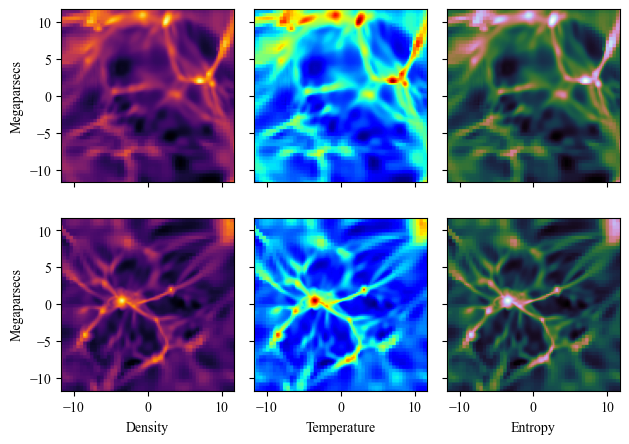

10 20


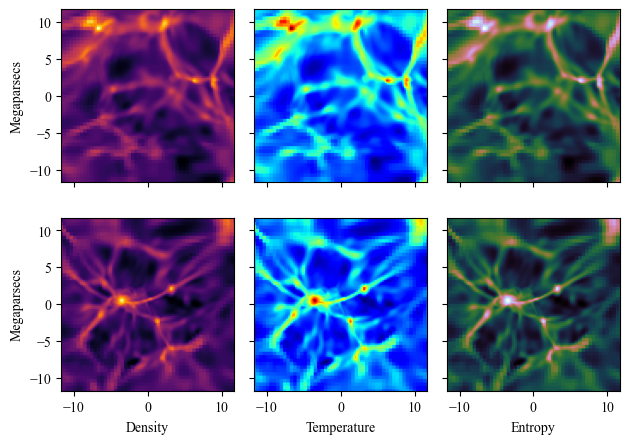

20 30


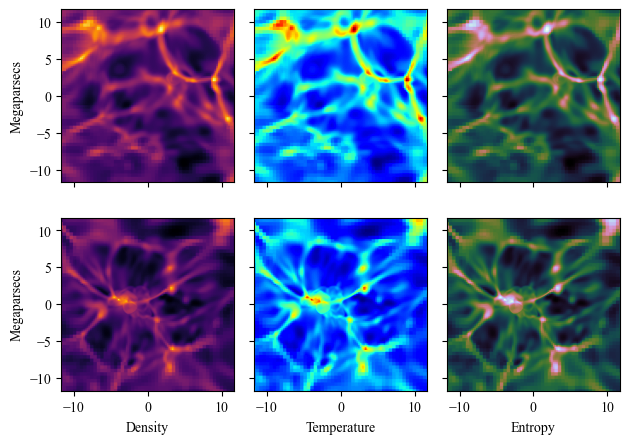

30 40


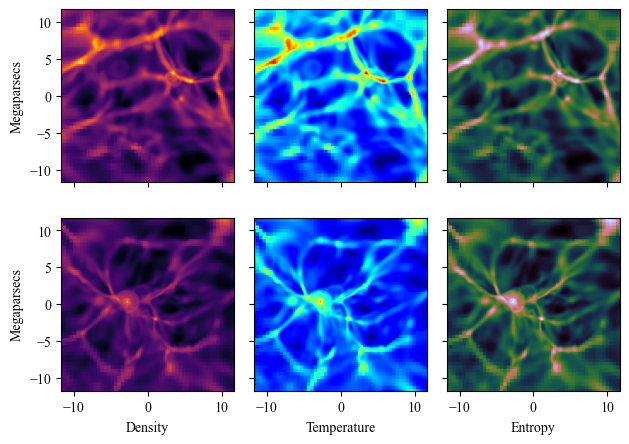

40 50


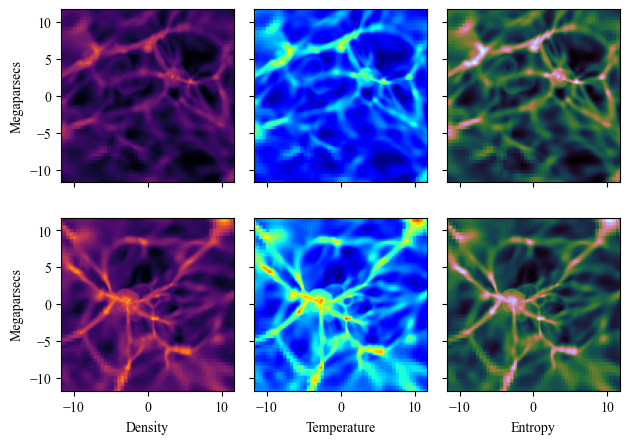

50 60


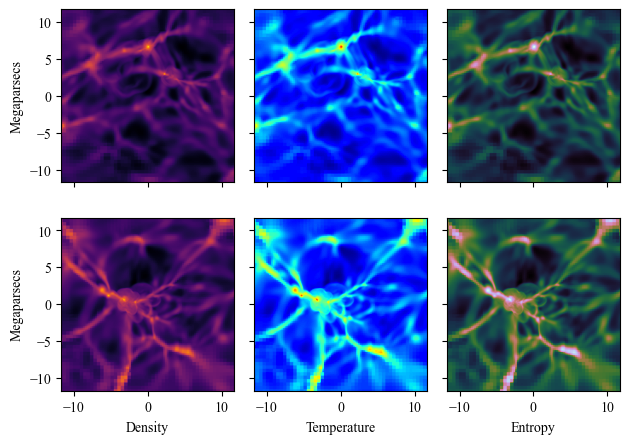

60 70


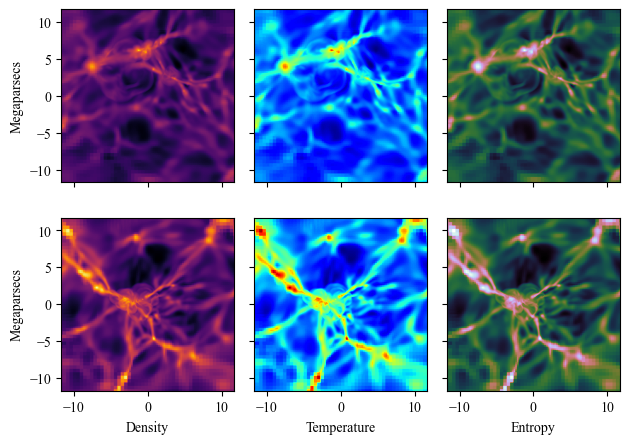

70 80


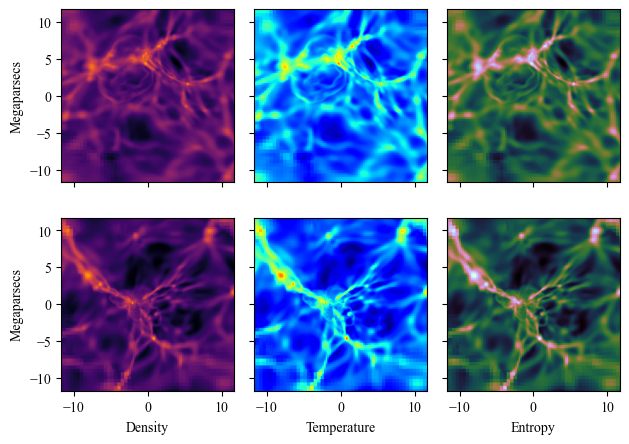

80 90


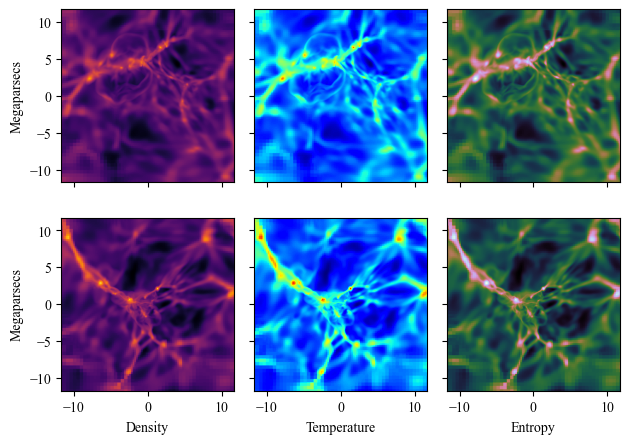

90 100


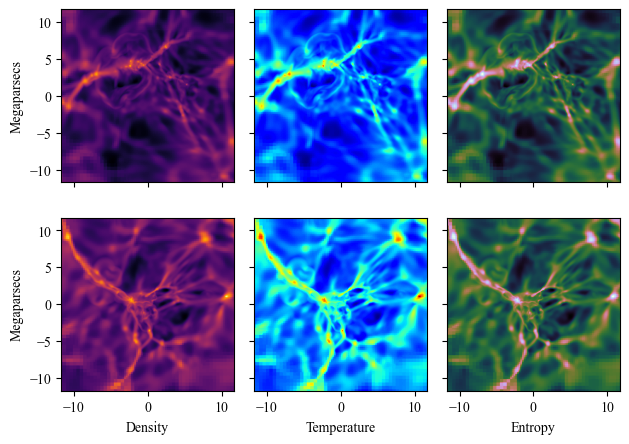

100 110


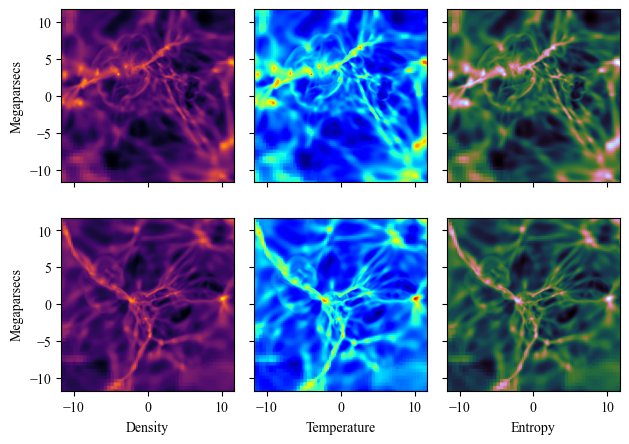

110 120


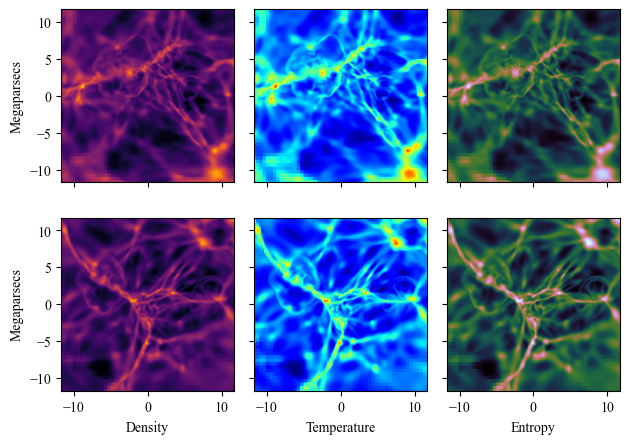

120 130


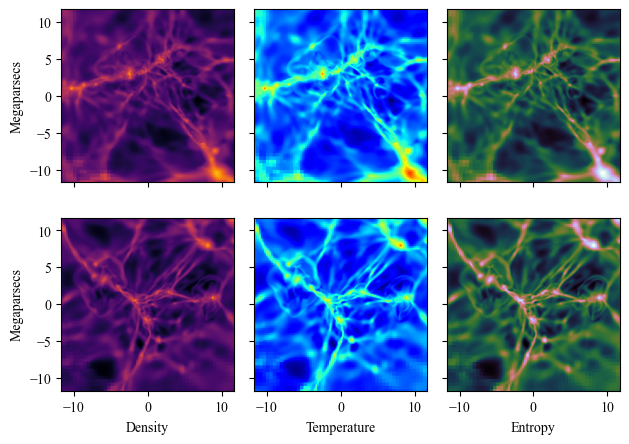

130 140


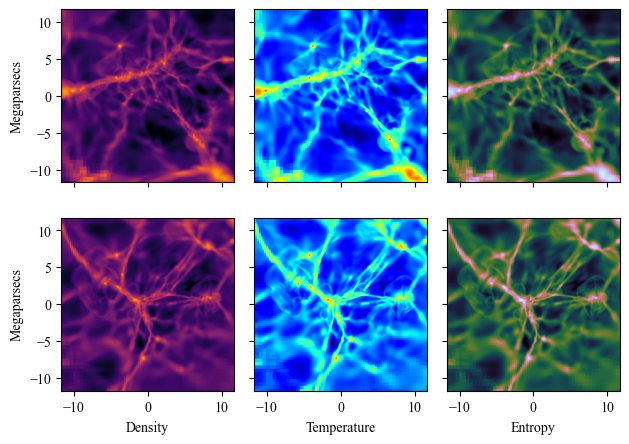

140 150


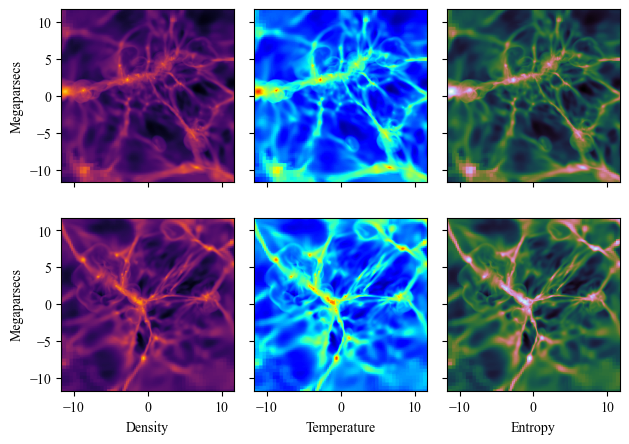

150 160


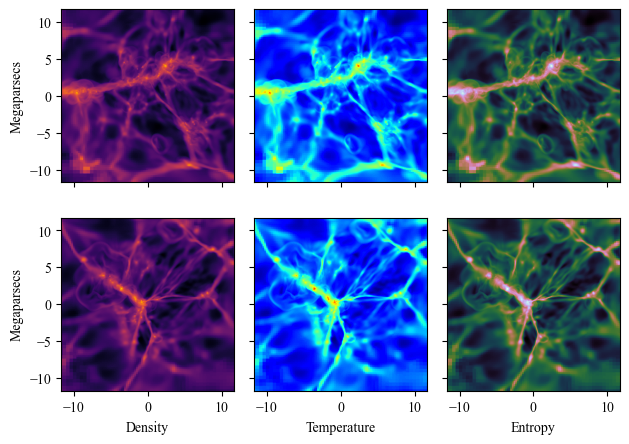

160 170


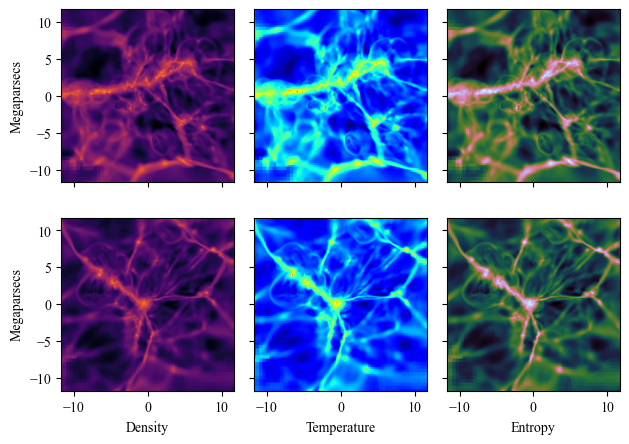

170 180


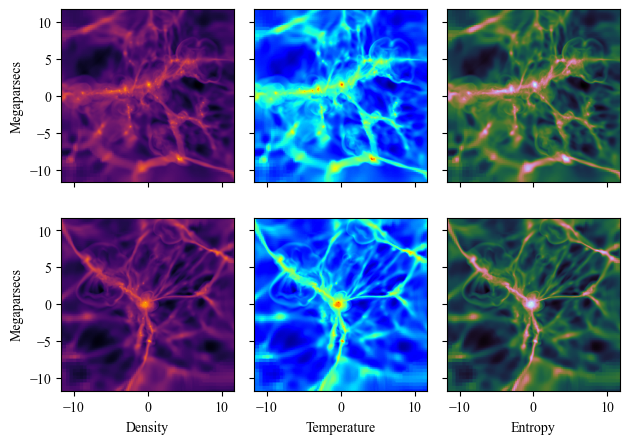

180 190


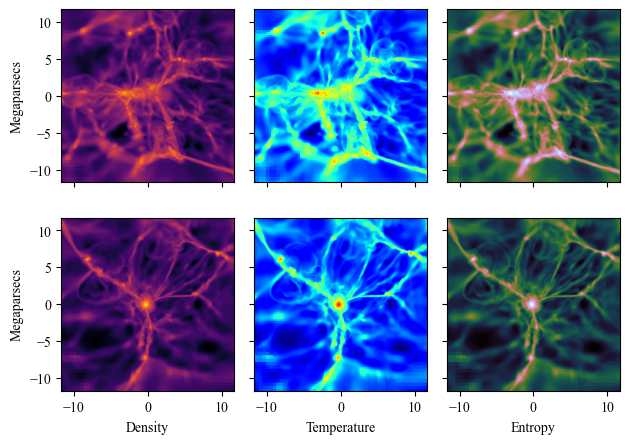

190 200


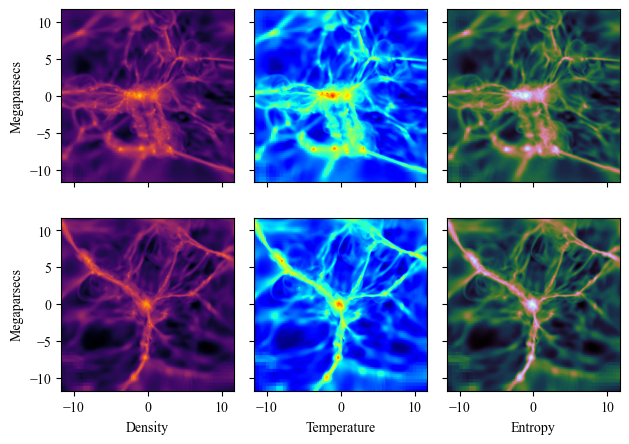

200 210


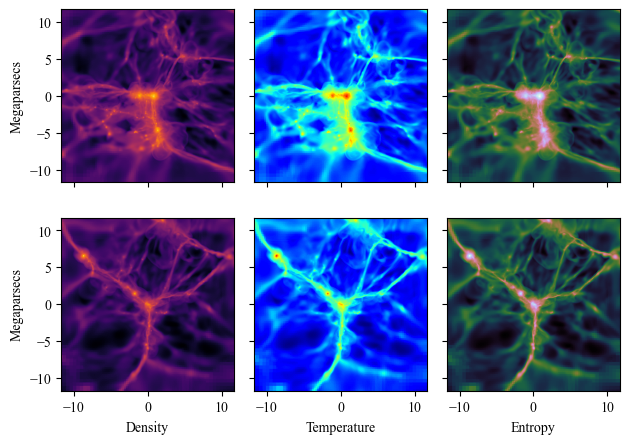

210 220


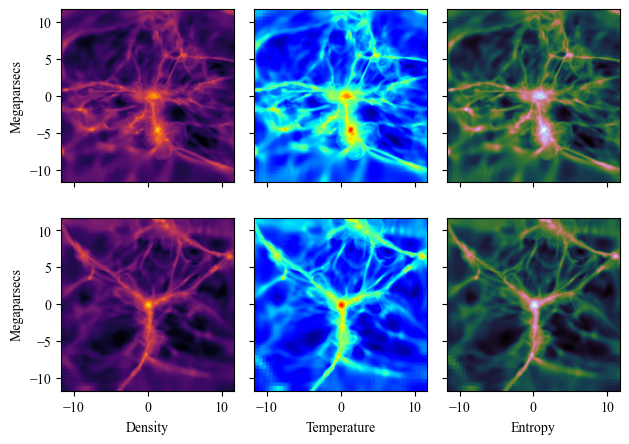

220 230


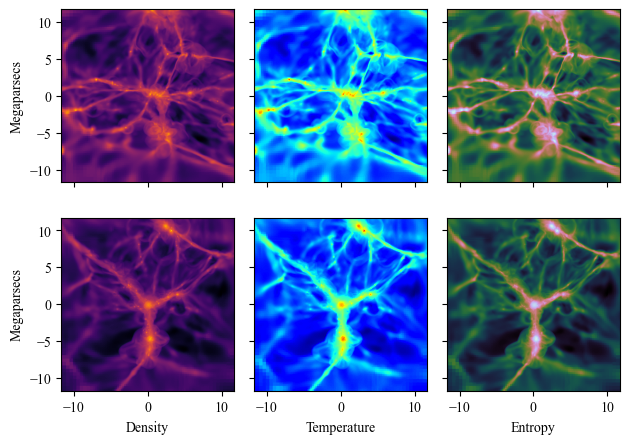

230 240


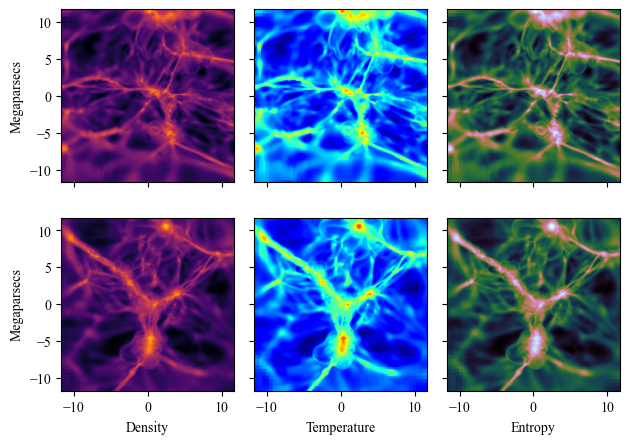

240 250


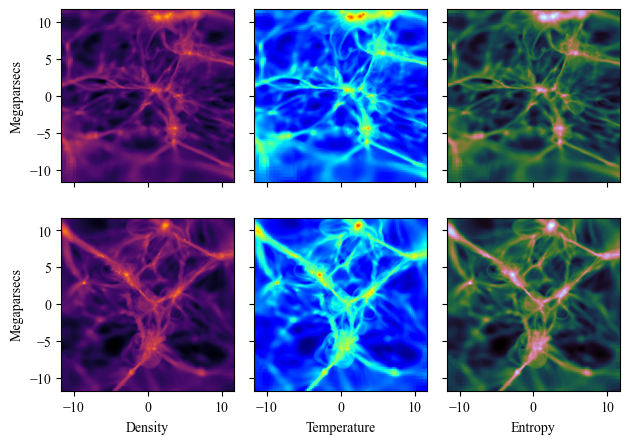

250 260


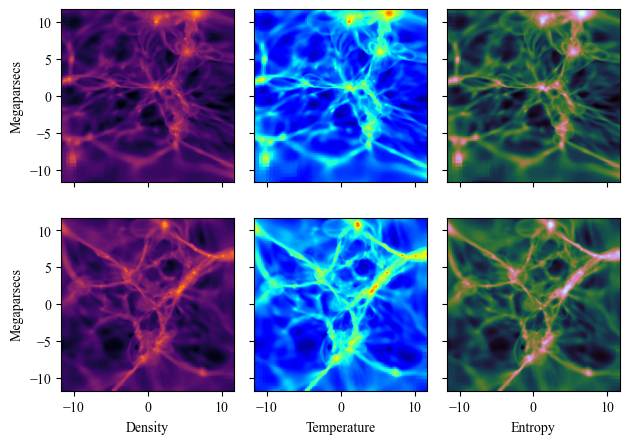

260 270


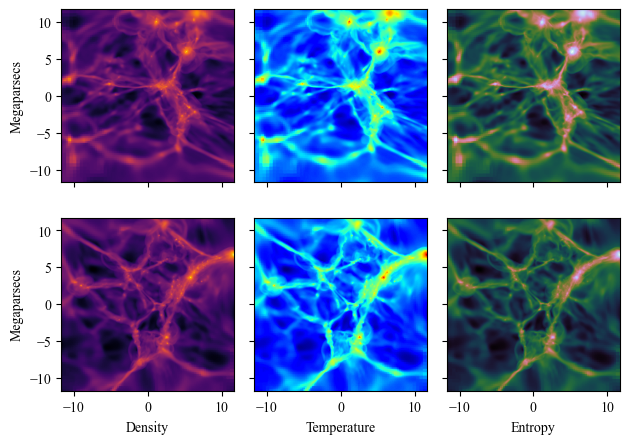

270 280


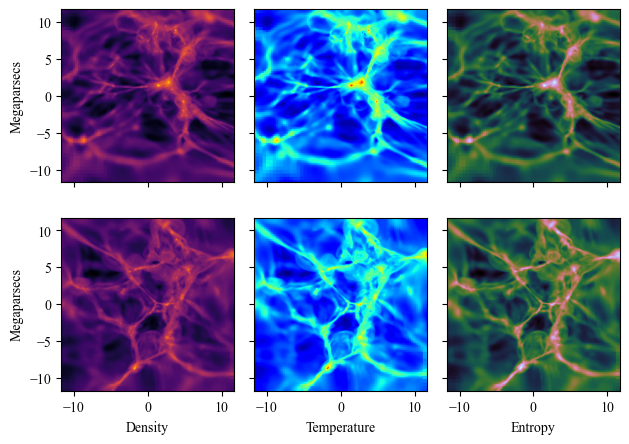

280 290


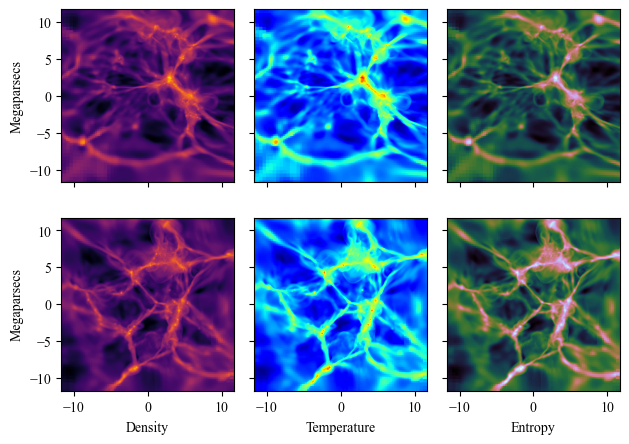

290 300


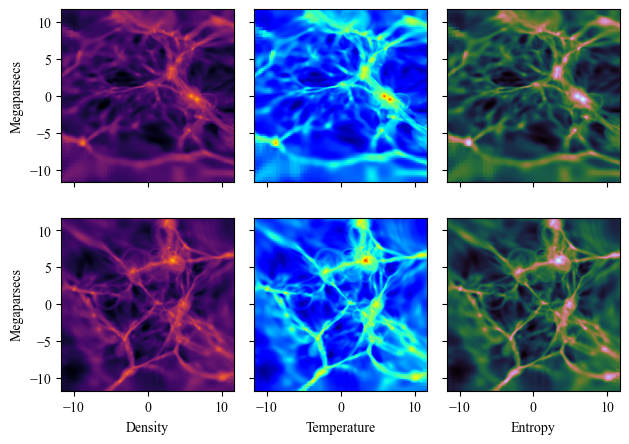

300 310


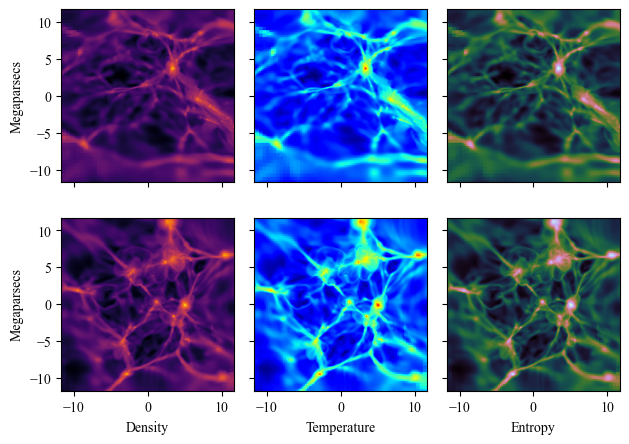

310 320


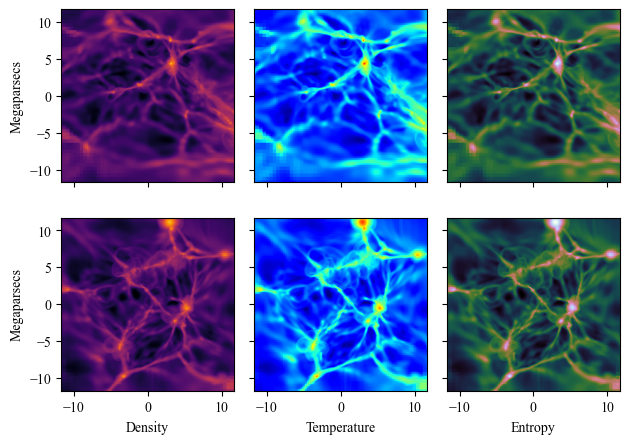

320 330


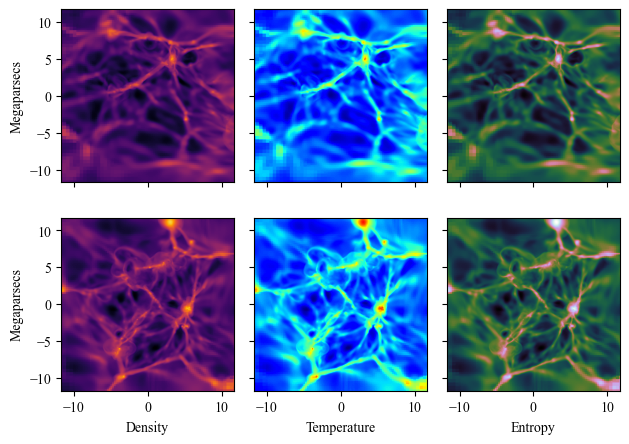

330 340


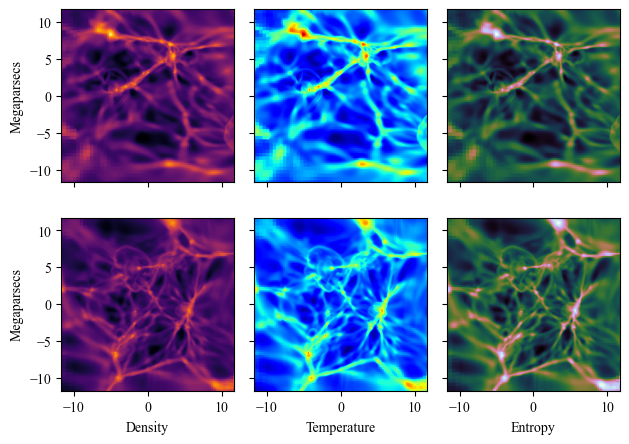

340 350


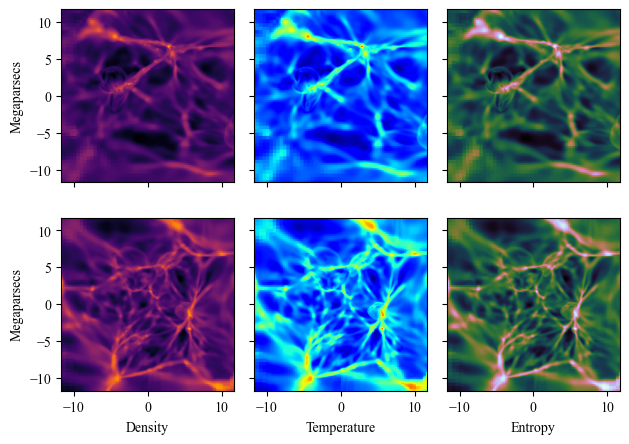

350 360


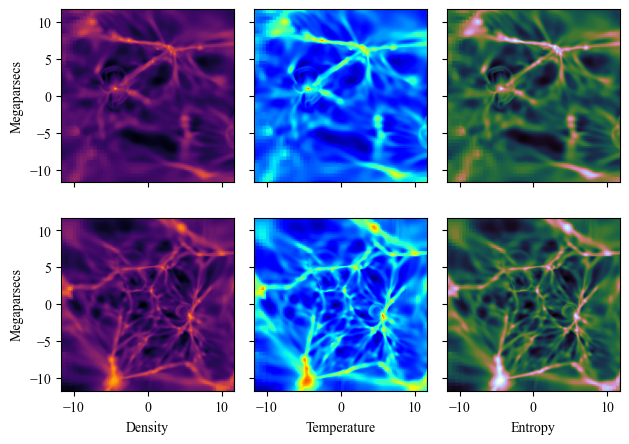

360 370


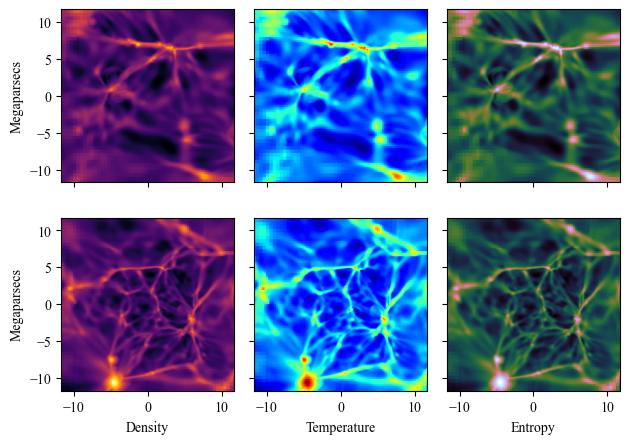

370 380


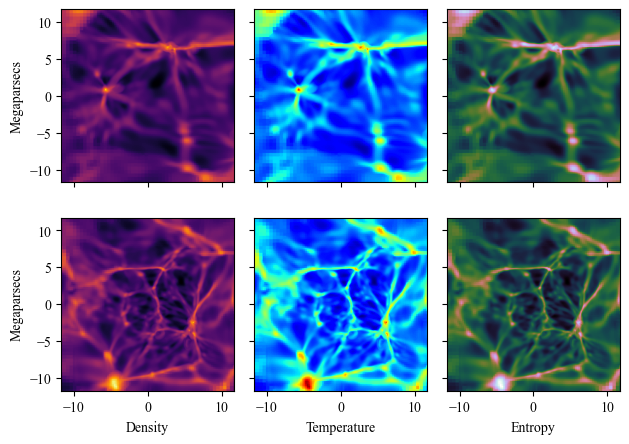

380 390


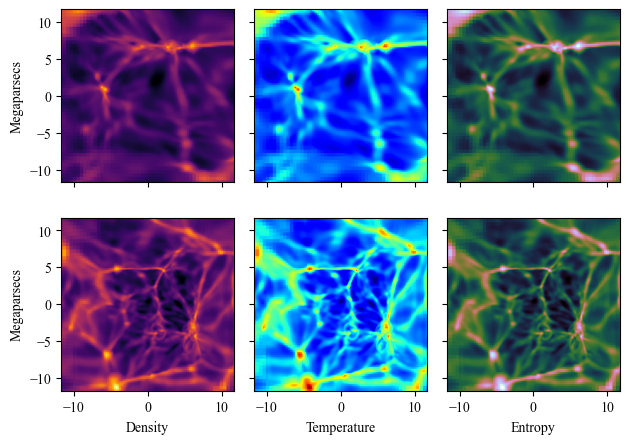

In [32]:
for i in range (39):
    n1 = i*10
    n2 = n1+10

    print(n1,n2)
    
    projr=np.sum(rho[1:409, n1:n2, 1:409],axis=1)
    projr = projr/(float(n2-n1+1))
    lrho=np.log10(projr)
    lrho1=np.log10(rho)
    
    projrb=np.sum(rho[1:409, 1:409, n1:n2],axis=2)
    projrb = projrb/(float(n2-n1+1))
    lrhob=np.log10(projrb)
    lrho1b=np.log10(rho)

    projT=np.sum(T[1:409, n1:n2,1:409],axis=1)
    lT=np.log10(projT)
    lT1=np.log10(T)

    projTb=np.sum(T[1:409, 1:409, n1:n2],axis=2)
    lTb=np.log10(projTb)
    lT1b=np.log10(T)

    lS=(3.0/2.0)*lrho1-lT1
    S=10**lS
    projS=np.sum(lS[1:409,n1:n2,1:409],axis=1)
    lS1=np.log10(projS)

    lSb=(3.0/2.0)*lrho1b-lT1b
    Sb=10**lSb
    projSb=np.sum(lS[1:409, 1:409, n1:n2],axis=2)
    lS1b=np.log10(projSb)
    
    fig, ax = plt.subplots(nrows= 2, ncols=3, sharey= True, sharex= True)
    plt.subplots_adjust(hspace = 0.0, wspace = 0.0)
    
    ax[0, 0].imshow(lrho,aspect='auto', cmap= plt.colormaps['inferno'], extent=[-23.402640586797066/2,23.402640586797066/2,-23.402640586797066/2,23.402640586797066/2])
    ax[0, 0].set_box_aspect(1)
    ax[0, 0].set_ylabel('Megaparsecs')
    
    ax[0, 1].imshow(lT,aspect='auto', cmap= plt.colormaps['jet'], extent=[-23.402640586797066/2,23.402640586797066/2,-23.402640586797066/2,23.402640586797066/2])
    ax[0, 1].set_box_aspect(1)

    ax[0, 2].imshow(projS,aspect='auto', cmap= plt.colormaps['cubehelix'], extent=[-23.402640586797066/2,23.402640586797066/2,-23.402640586797066/2,23.402640586797066/2])
    ax[0, 2].set_box_aspect(1)

    ax[1, 0].imshow(lrhob,aspect='auto', cmap= plt.colormaps['inferno'], extent=[-23.402640586797066/2,23.402640586797066/2,-23.402640586797066/2,23.402640586797066/2])
    ax[1, 0].set_box_aspect(1)
    ax[1, 0].set_ylabel('Megaparsecs')
    ax[1, 0].set_xlabel('Density')
    
    ax[1, 1].imshow(lTb,aspect='auto', cmap= plt.colormaps['jet'], extent=[-23.402640586797066/2,23.402640586797066/2,-23.402640586797066/2,23.402640586797066/2])
    ax[1, 1].set_box_aspect(1)
    ax[1, 1].set_xlabel('Temperature')

    ax[1, 2].imshow(projSb, aspect='auto', cmap= plt.colormaps['cubehelix'], extent=[-23.402640586797066/2,23.402640586797066/2,-23.402640586797066/2,23.402640586797066/2])
    ax[1, 2].set_box_aspect(1)
    ax[1, 2].set_xlabel('Entropy')



    #slice = "slice"+ str(n1) + "-" +str(n2) + "_2rows"
    #save_to = '/Users/zaraafrooz/Desktop/proj_y_rho_T_ent/'
    #plt.savefig(save_to + str(slice) + '.png' , dpi= 300)

    plt.tight_layout()
    plt.show()

#### Plotting temperature, density, and entropy distribution by projecting X, Y, Z-Axis in their respective rows every 10-pixel sections


0 10


/var/folders/43/phhlpyxx78q6pmmcs6tg_l400000gp/T/ipykernel_37105/919582759.py:37: RuntimeWarning: invalid value encountered in log10
  lS1=np.log10(projS)
/var/folders/43/phhlpyxx78q6pmmcs6tg_l400000gp/T/ipykernel_37105/919582759.py:42: RuntimeWarning: invalid value encountered in log10
  lS1b=np.log10(projSb)
/var/folders/43/phhlpyxx78q6pmmcs6tg_l400000gp/T/ipykernel_37105/919582759.py:47: RuntimeWarning: invalid value encountered in log10
  lS1c=np.log10(projSc)


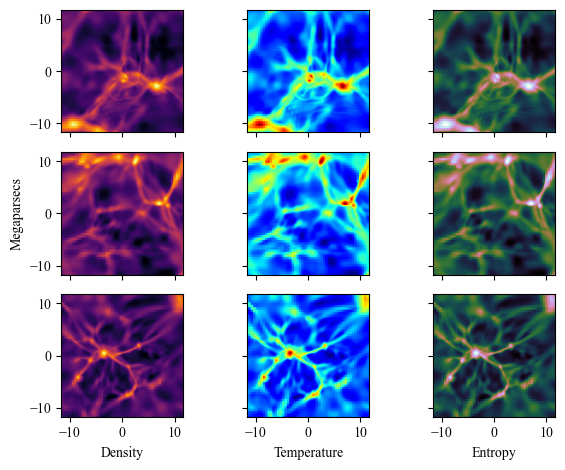

10 20


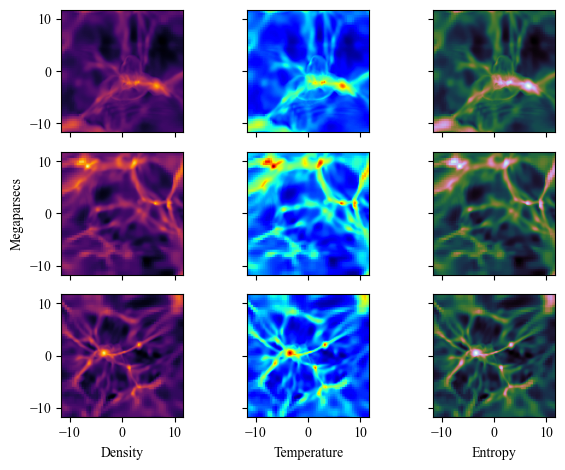

20 30


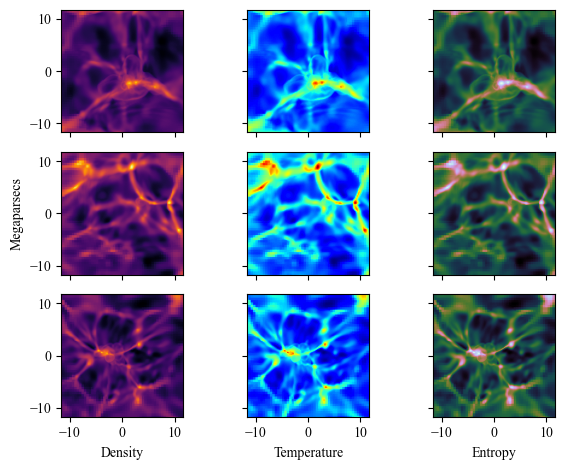

30 40


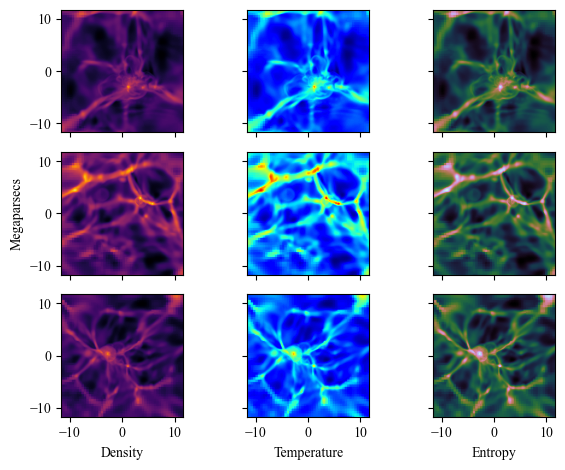

40 50


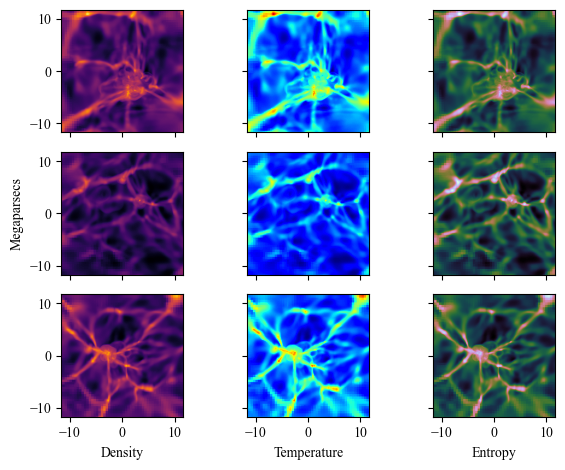

50 60


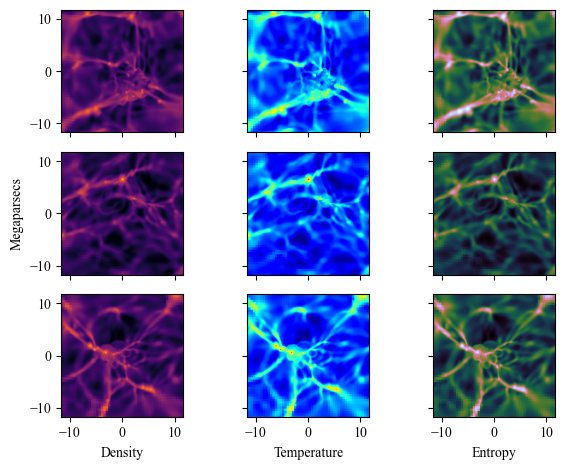

60 70


In [33]:
for i in range (39):
    n1 = i*10
    n2 = n1+10

    print(n1,n2)
    
    projr=np.sum(rho[n1:n2, 1:409, 1:409],axis=0)
    projr = projr/(float(n2-n1+1))
    lrho=np.log10(projr)
    lrho1=np.log10(rho)
    
    projrb=np.sum(rho[1:409, n1:n2, 1:409],axis=1)
    projrb = projrb/(float(n2-n1+1))
    lrhob=np.log10(projrb)
    lrho1b=np.log10(rho)

    projrc=np.sum(rho[1:409, 1:409, n1:n2],axis=2)
    projrc = projrc/(float(n2-n1+1))
    lrhoc=np.log10(projrc)
    lrho1c=np.log10(rho)

    projT=np.sum(T[n1:n2, 1:409, 1:409],axis=0)
    lT=np.log10(projT)
    lT1=np.log10(T)

    projTb=np.sum(T[1:409, n1:n2,1:409],axis=1)
    lTb=np.log10(projTb)
    lT1b=np.log10(T)

    projTc=np.sum(T[1:409, 1:409, n1:n2],axis=2)
    lTc=np.log10(projTc)
    lT1c=np.log10(T)

    lS=(3.0/2.0)*lrho1-lT1
    S=10**lS
    projS=np.sum(lS[n1:n2, 1:409, 1:409],axis=0)
    lS1=np.log10(projS)

    lSb=(3.0/2.0)*lrho1b-lT1b
    Sb=10**lS
    projSb=np.sum(lS[1:409, n1:n2, 1:409],axis=1)
    lS1b=np.log10(projSb)

    lS=(3.0/2.0)*lrho1c-lT1c
    Sc=10**lS
    projSc=np.sum(lS[1:409, 1:409, n1:n2],axis=2)
    lS1c=np.log10(projSc)
    
    fig, ax = plt.subplots(nrows= 3, ncols=3, sharey= True, sharex= True)
    plt.subplots_adjust(hspace = 0.0, wspace = 0.0)
    
    ax[0, 0].imshow(lrho,aspect='auto', cmap= plt.colormaps['inferno'], extent=[-23.402640586797066/2,23.402640586797066/2,-23.402640586797066/2,23.402640586797066/2])
    ax[0, 0].set_box_aspect(1)
    # ax[0, 0].set_ylabel('Megaparsecs')
    
    ax[0, 1].imshow(lT,aspect='auto', cmap= plt.colormaps['jet'], extent=[-23.402640586797066/2,23.402640586797066/2,-23.402640586797066/2,23.402640586797066/2])
    ax[0, 1].set_box_aspect(1)

    ax[0, 2].imshow(projS,aspect='auto', cmap= plt.colormaps['cubehelix'], extent=[-23.402640586797066/2,23.402640586797066/2,-23.402640586797066/2,23.402640586797066/2])
    ax[0, 2].set_box_aspect(1)

    ax[1, 0].imshow(lrhob,aspect='auto', cmap= plt.colormaps['inferno'], extent=[-23.402640586797066/2,23.402640586797066/2,-23.402640586797066/2,23.402640586797066/2])
    ax[1, 0].set_box_aspect(1)
    ax[1, 0].set_ylabel('Megaparsecs')
    
    ax[1, 1].imshow(lTb,aspect='auto', cmap= plt.colormaps['jet'], extent=[-23.402640586797066/2,23.402640586797066/2,-23.402640586797066/2,23.402640586797066/2])
    ax[1, 1].set_box_aspect(1)

    ax[1, 2].imshow(projSb, aspect='auto', cmap= plt.colormaps['cubehelix'], extent=[-23.402640586797066/2,23.402640586797066/2,-23.402640586797066/2,23.402640586797066/2])
    ax[1, 2].set_box_aspect(1)

    ax[2, 0].imshow(lrhoc,aspect='auto', cmap= plt.colormaps['inferno'], extent=[-23.402640586797066/2,23.402640586797066/2,-23.402640586797066/2,23.402640586797066/2])
    ax[2, 0].set_box_aspect(1)
    # ax[2, 0].set_ylabel('Megaparsecs')
    ax[2, 0].set_xlabel('Density')
    
    ax[2, 1].imshow(lTc,aspect='auto', cmap= plt.colormaps['jet'], extent=[-23.402640586797066/2,23.402640586797066/2,-23.402640586797066/2,23.402640586797066/2])
    ax[2, 1].set_box_aspect(1)
    ax[2, 1].set_xlabel('Temperature')

    ax[2, 2].imshow(projSc, aspect='auto', cmap= plt.colormaps['cubehelix'], extent=[-23.402640586797066/2,23.402640586797066/2,-23.402640586797066/2,23.402640586797066/2])
    ax[2, 2].set_box_aspect(1)
    ax[2, 2].set_xlabel('Entropy')



    # slice = "slice"+ str(n1) + "-" +str(n2) + "_3rows"
    # save_to = '/Users/zaraafrooz/Desktop/proj_y_rho_T_ent/'
    # plt.savefig(save_to + str(slice) + '.png' , dpi= 300)

    plt.tight_layout()
    plt.show()
